In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import os, sys, gc, warnings, random, datetime, math, psutil
from multiprocessing import Pool
import logging
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, KNNImputer
from scipy.stats import chi2_contingency

In [19]:
# transaction
url = r'https://drive.google.com/file/d/1EznuwPohSIzh0HZn5Fy0K5NApK3W4Clf/view?usp=share_link'
url = 'https://drive.google.com/uc?id=' + url.split('/')[-2]
df_transaction = pd.read_parquet(url)
df_transaction.head()


,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [20]:
# identity
url = r'https://drive.google.com/file/d/1o0w9UnbUnf2mGk85KCYq6i2Ojv4UyZvR/view?usp=share_link'
url = 'https://drive.google.com/uc?id=' + url.split('/')[-2]
df_identity = pd.read_csv(url)
df_identity.head()

,TransactionID,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987004,0.0,70787.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M
1,2987008,-5.0,98945.0,NaN,NaN,0.0,-5.0,NaN,NaN,NaN,...,mobile safari 11.0,32.0,1334x750,match_status:1,T,F,F,T,mobile,iOS Device
2,2987010,-5.0,191631.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,...,chrome 62.0,NaN,NaN,NaN,F,F,T,T,desktop,Windows
3,2987011,-5.0,221832.0,NaN,NaN,0.0,-6.0,NaN,NaN,NaN,...,chrome 62.0,NaN,NaN,NaN,F,F,T,T,desktop,NaN
4,2987016,0.0,7460.0,0.0,0.0,1.0,0.0,NaN,NaN,0.0,...,chrome 62.0,24.0,1280x800,match_status:2,T,F,T,T,desktop,MacOS


In [6]:
df_identity.TransactionID.nunique()

144233

In [8]:
df_transaction.TransactionID.nunique()

590540

In [9]:
df_transaction.shape

(590540, 394)

In [10]:
df_transaction.info

<bound method DataFrame.info of         TransactionID  isFraud  TransactionDT  TransactionAmt ProductCD  \
0             2987000        0          86400           68.50         W   
1             2987001        0          86401           29.00         W   
2             2987002        0          86469           59.00         W   
3             2987003        0          86499           50.00         W   
4             2987004        0          86506           50.00         H   
...               ...      ...            ...             ...       ...   
590535        3577535        0       15811047           49.00         W   
590536        3577536        0       15811049           39.50         W   
590537        3577537        0       15811079           30.95         W   
590538        3577538        0       15811088          117.00         W   
590539        3577539        0       15811131          279.95         W   

        card1  card2  card3       card4  card5  ... V330  V331  V33

In [18]:
df_transaction.describe()

,TransactionID,isFraud,TransactionDT,TransactionAmt,card1,card2,card3,card5,addr1,addr2,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
count,5.905400e+05,590540.000000,5.905400e+05,590540.000000,590540.000000,581607.000000,588975.000000,586281.000000,524834.000000,524834.000000,...,82351.000000,82351.000000,82351.000000,82351.000000,82351.000000,82351.00000,82351.000000,82351.000000,82351.000000,82351.000000
mean,3.282270e+06,0.034990,7.372311e+06,135.027176,9898.734658,362.555488,153.194925,199.278897,290.733794,86.800630,...,0.775874,721.741883,1375.783644,1014.622782,9.807015,59.16455,28.530903,55.352422,151.160542,100.700882
std,1.704744e+05,0.183755,4.617224e+06,239.162522,4901.170153,157.793246,11.336444,41.244453,101.741072,2.690623,...,4.727971,6217.223583,11169.275702,7955.735482,243.861391,387.62948,274.576920,668.486833,1095.034387,814.946722
min,2.987000e+06,0.000000,8.640000e+04,0.251000,1000.000000,100.000000,100.000000,100.000000,100.000000,10.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
25%,3.134635e+06,0.000000,3.027058e+06,43.321000,6019.000000,214.000000,150.000000,166.000000,204.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
50%,3.282270e+06,0.000000,7.306528e+06,68.769000,9678.000000,361.000000,150.000000,226.000000,299.000000,87.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
75%,3.429904e+06,0.000000,1.124662e+07,125.000000,14184.000000,512.000000,150.000000,226.000000,330.000000,87.000000,...,0.000000,0.000000,25.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000
max,3.577539e+06,1.000000,1.581113e+07,31937.391000,18396.000000,600.000000,231.000000,237.000000,540.000000,102.000000,...,55.000000,160000.000000,160000.000000,160000.000000,55125.000000,55125.00000,55125.000000,104060.000000,104060.000000,104060.000000


In [11]:
df_identity.shape

(144233, 41)

In [12]:
df_identity.info

<bound method DataFrame.info of         TransactionID  id_01     id_02  id_03  id_04  id_05  id_06  id_07  \
0             2987004    0.0   70787.0    NaN    NaN    NaN    NaN    NaN   
1             2987008   -5.0   98945.0    NaN    NaN    0.0   -5.0    NaN   
2             2987010   -5.0  191631.0    0.0    0.0    0.0    0.0    NaN   
3             2987011   -5.0  221832.0    NaN    NaN    0.0   -6.0    NaN   
4             2987016    0.0    7460.0    0.0    0.0    1.0    0.0    NaN   
...               ...    ...       ...    ...    ...    ...    ...    ...   
144228        3577521  -15.0  145955.0    0.0    0.0    0.0    0.0    NaN   
144229        3577526   -5.0  172059.0    NaN    NaN    1.0   -5.0    NaN   
144230        3577529  -20.0  632381.0    NaN    NaN   -1.0  -36.0    NaN   
144231        3577531   -5.0   55528.0    0.0    0.0    0.0   -7.0    NaN   
144232        3577534  -45.0  339406.0    NaN    NaN  -10.0 -100.0    NaN   

        id_08  id_09  ...                  

In [13]:
df_identity.describe()

,TransactionID,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,...,id_17,id_18,id_19,id_20,id_21,id_22,id_24,id_25,id_26,id_32
count,1.442330e+05,144233.000000,140872.000000,66324.000000,66324.000000,136865.000000,136865.000000,5155.000000,5155.000000,74926.000000,...,139369.000000,45113.000000,139318.000000,139261.000000,5159.000000,5169.000000,4747.000000,5132.000000,5163.000000,77586.000000
mean,3.236329e+06,-10.170502,174716.584708,0.060189,-0.058938,1.615585,-6.698710,13.285354,-38.600388,0.091023,...,189.451377,14.237337,353.128174,403.882666,368.269820,16.002708,12.800927,329.608924,149.070308,26.508597
std,1.788496e+05,14.347949,159651.816856,0.598231,0.701015,5.249856,16.491104,11.384207,26.084899,0.983842,...,30.375360,1.561302,141.095343,152.160327,198.847038,6.897665,2.372447,97.461089,32.101995,3.737502
min,2.987004e+06,-100.000000,1.000000,-13.000000,-28.000000,-72.000000,-100.000000,-46.000000,-100.000000,-36.000000,...,100.000000,10.000000,100.000000,100.000000,100.000000,10.000000,11.000000,100.000000,100.000000,0.000000
25%,3.077142e+06,-10.000000,67992.000000,0.000000,0.000000,0.000000,-6.000000,5.000000,-48.000000,0.000000,...,166.000000,13.000000,266.000000,256.000000,252.000000,14.000000,11.000000,321.000000,119.000000,24.000000
50%,3.198818e+06,-5.000000,125800.500000,0.000000,0.000000,0.000000,0.000000,14.000000,-34.000000,0.000000,...,166.000000,15.000000,341.000000,472.000000,252.000000,14.000000,11.000000,321.000000,149.000000,24.000000
75%,3.392923e+06,-5.000000,228749.000000,0.000000,0.000000,1.000000,0.000000,22.000000,-23.000000,0.000000,...,225.000000,15.000000,427.000000,533.000000,486.500000,14.000000,15.000000,371.000000,169.000000,32.000000
max,3.577534e+06,0.000000,999595.000000,10.000000,0.000000,52.000000,0.000000,61.000000,0.000000,25.000000,...,229.000000,29.000000,671.000000,661.000000,854.000000,44.000000,26.000000,548.000000,216.000000,32.000000


df_transaction.TransactionID.nunique()

In [14]:
df_identity.TransactionID.nunique()

144233

A lot of transaction without corresponding identity, we do a left join

## Transaction

### TransactionAMT

In [15]:
color_pal = [x['color'] for x in plt.rcParams['axes.prop_cycle']]

Transaction Amounts Quantiles:
0.010       9.2440
0.025      14.5010
0.100      25.9500
0.250      43.3210
0.500      68.7690
0.750     125.0000
0.900     275.2930
0.975     648.3345
0.990    1104.0000
Name: TransactionAmt, dtype: float64


(-100.0, 100000.0)

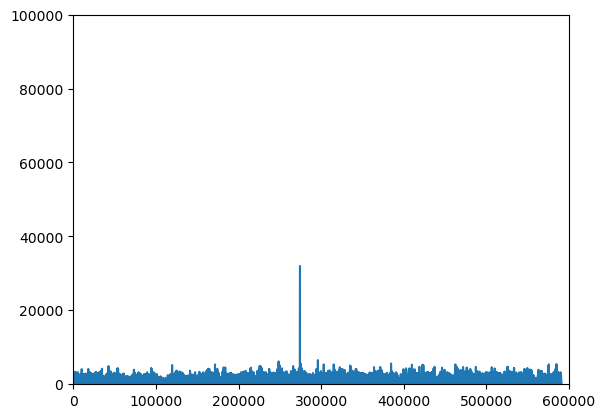

In [16]:
df_transaction['TransactionAmt'] = df_transaction['TransactionAmt'].astype(float)
print("Transaction Amounts Quantiles:")
print(df_transaction['TransactionAmt'].quantile([.01, .025, .1, .25, .5, .75, .9, .975, .99]))
plt.plot(df_transaction['TransactionAmt'])
plt.xlim(-500, 600000)
plt.ylim(-100, 100000)

### TransactionDT

Transaction Amounts Quantiles:
0.010      185058.82
0.025      414800.70
0.100     1361004.40
0.250     3027057.75
0.500     7306527.50
0.750    11246620.00
0.900    13990907.70
0.975    15291965.35
0.990    15629766.04
Name: TransactionDT, dtype: float64


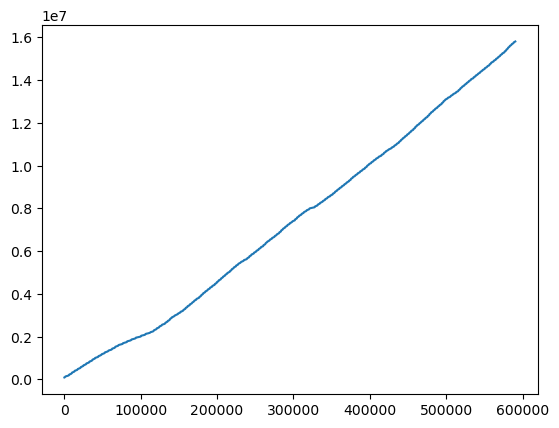

In [90]:
df_transaction['TransactionDT'] = df_transaction['TransactionDT'].astype(float)
print("Transaction Amounts Quantiles:")
print(df_transaction['TransactionDT'].quantile([.01, .025, .1, .25, .5, .75, .9, .975, .99]))
plt.plot(df_transaction['TransactionDT'])

### ProductCD

<AxesSubplot:title={'center':'Count of ProductCD'}, ylabel='ProductCD'>

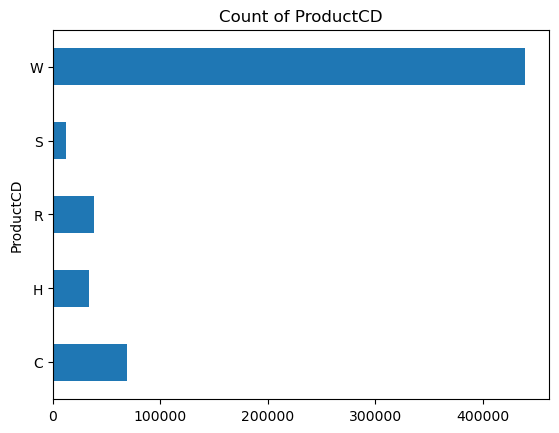

In [95]:
df_transaction.groupby('ProductCD')['ProductCD'].count().plot(kind='barh', title='Count of ProductCD')

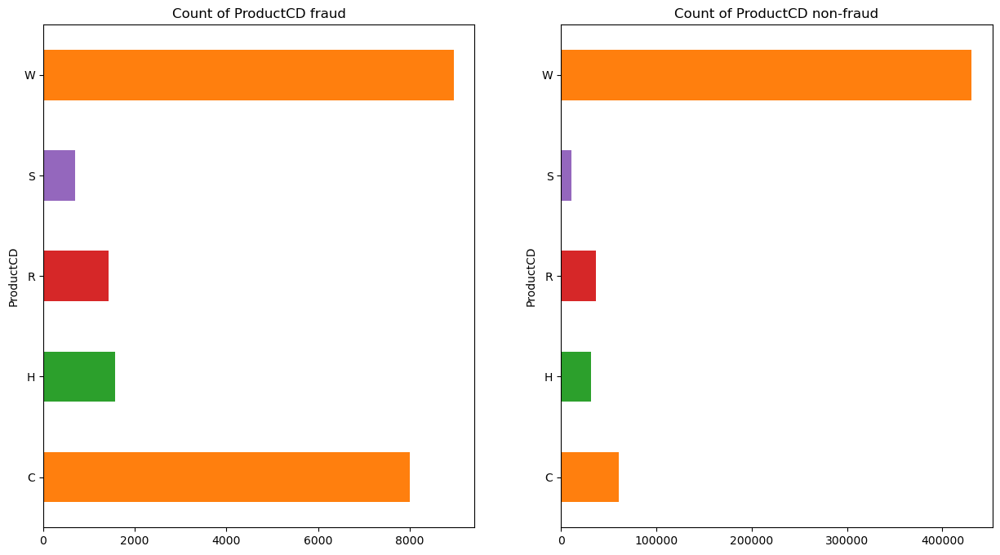

In [105]:
df_transaction_fr = df_transaction.loc[df_transaction['isFraud'] == 1]
df_transaction_nofr = df_transaction.loc[df_transaction['isFraud'] == 0]
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 8))
df_transaction_fr.groupby('ProductCD')['ProductCD'].count().plot(kind='barh', ax=ax1, title='Count of ProductCD fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('ProductCD')['ProductCD'].count().plot(kind='barh', ax=ax2, title='Count of ProductCD non-fraud',color = color_pal[1:5])
plt.show()

### card1-card6

In [99]:
card_cols = [c for c in df_transaction.columns if 'card' in c]
df_transaction[card_cols].head()

,card1,card2,card3,card4,card5,card6
0,13926,NaN,150.0,discover,142.0,credit
1,2755,404.0,150.0,mastercard,102.0,credit
2,4663,490.0,150.0,visa,166.0,debit
3,18132,567.0,150.0,mastercard,117.0,debit
4,4497,514.0,150.0,mastercard,102.0,credit


Since we get categorical value, we want to draw histgraph plot about the features with numerical values.

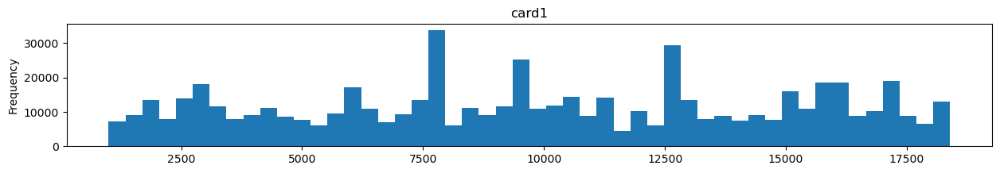

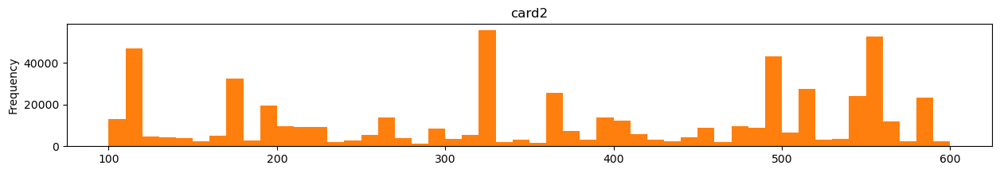

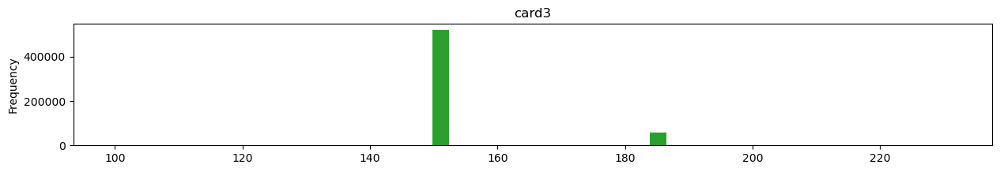

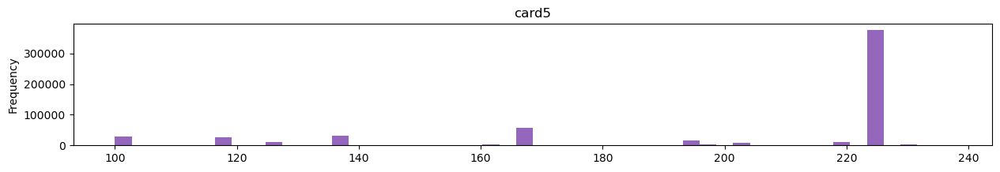

In [101]:
color_idx = 0
for c in card_cols:
    if df_transaction[c].dtype in ['float64','int64']:
        df_transaction[c].plot(kind='hist',
                                      title=c,
                                      bins=50,
                                      figsize=(15, 2),
                                      color=color_pal[color_idx])
    color_idx += 1
    plt.show()

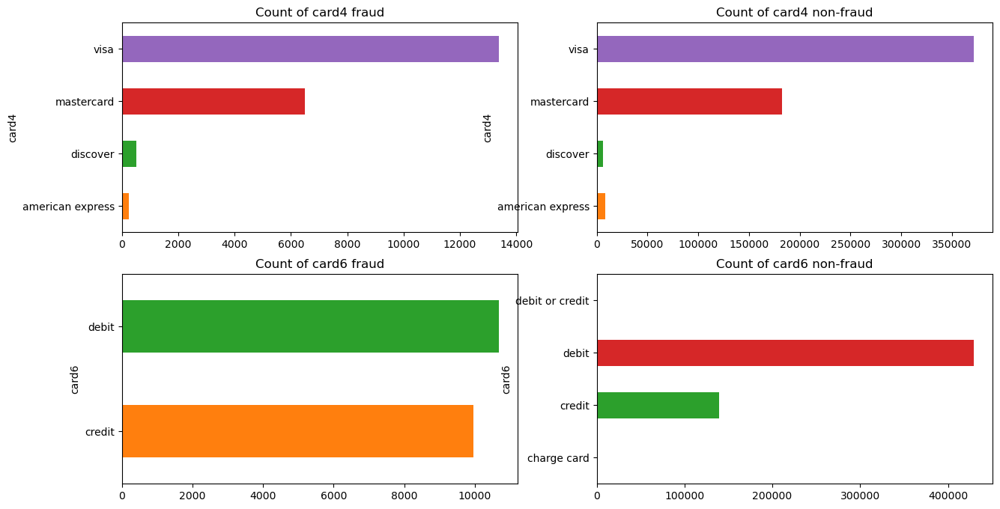

In [110]:
df_transaction_fr = df_transaction.loc[df_transaction['isFraud'] == 1]
df_transaction_nofr = df_transaction.loc[df_transaction['isFraud'] == 0]
fig, ((ax1, ax2),(ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 8))
df_transaction_fr.groupby('card4')['card4'].count().plot(kind='barh', ax=ax1, title='Count of card4 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('card4')['card4'].count().plot(kind='barh', ax=ax2, title='Count of card4 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('card6')['card6'].count().plot(kind='barh', ax=ax3, title='Count of card6 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('card6')['card6'].count().plot(kind='barh', ax=ax4, title='Count of card6 non-fraud',color = color_pal[1:5])
plt.show()

### addr1&2

In [111]:
addr_cols = [c for c in df_transaction.columns if 'addr' in c]
df_transaction[addr_cols].head()

,addr1,addr2
0,315.0,87.0
1,325.0,87.0
2,330.0,87.0
3,476.0,87.0
4,420.0,87.0


<AxesSubplot:title={'center':'addr1 distribution'}, ylabel='Frequency'>

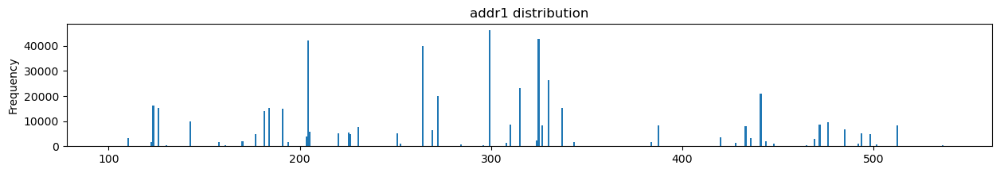

In [113]:
df_transaction['addr1'].plot(kind='hist', bins=500, figsize=(15, 2), title='addr1 distribution')

<AxesSubplot:title={'center':'addr12 distribution'}, ylabel='Frequency'>

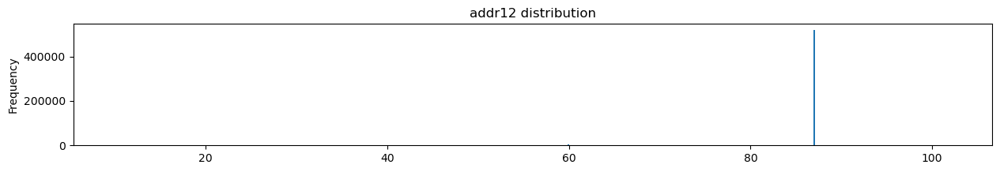

In [114]:
df_transaction['addr2'].plot(kind='hist', bins=500, figsize=(15, 2), title='addr12 distribution')

### dist1&2

In [122]:
dist_cols = [c for c in df_transaction.columns if 'dist' in c]
df_transaction[dist_cols].head()

,dist1,dist2
0,19.0,NaN
1,NaN,NaN
2,287.0,NaN
3,NaN,NaN
4,NaN,NaN


<AxesSubplot:title={'center':'dist1 distribution'}, ylabel='Frequency'>

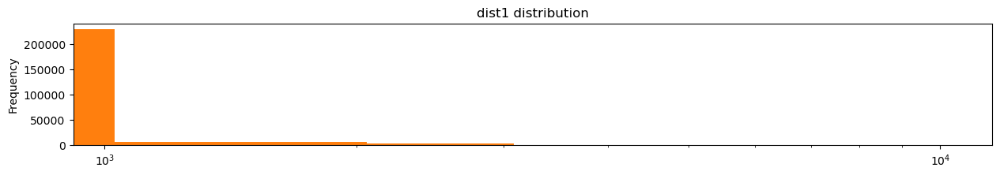

In [123]:
df_transaction['dist1'].plot(kind='hist',figsize=(15, 2),title='dist1 distribution',color=color_pal[1],logx=True)

<AxesSubplot:title={'center':'dist1 distribution'}, ylabel='Frequency'>

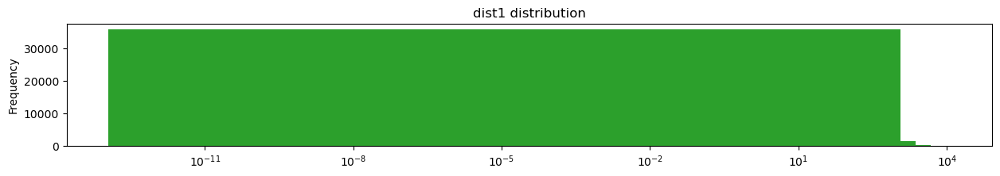

In [124]:
df_transaction['dist2'].plot(kind='hist',figsize=(15, 2),title='dist1 distribution',color=color_pal[2],logx=True)

### P_ and (R_) emaildomation

In [228]:
P_R_cols = [c for c in df_transaction.columns if 'emaildomain' in c]
df_transaction[P_R_cols]

,P_emaildomain,R_emaildomain
0,None,None
1,gmail.com,None
2,outlook.com,None
3,yahoo.com,None
4,gmail.com,None
...,...,...
590535,None,None
590536,gmail.com,None
590537,gmail.com,None
590538,aol.com,None


### D1-D15

In [202]:
D_cols = [c for c in df_transaction.columns if 'D' in c]
df_transaction[D_cols]

,TransactionID,TransactionDT,ProductCD,D1,D2,D3,D4,D5,D6,D7,D8,D9,D10,D11,D12,D13,D14,D15
0,2987000,86400.0,W,14.0,NaN,13.0,NaN,NaN,NaN,NaN,NaN,NaN,13.0,13.0,NaN,NaN,NaN,0.0
1,2987001,86401.0,W,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,0.0
2,2987002,86469.0,W,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,315.0,NaN,NaN,NaN,315.0
3,2987003,86499.0,W,112.0,112.0,0.0,94.0,0.0,NaN,NaN,NaN,NaN,84.0,NaN,NaN,NaN,NaN,111.0
4,2987004,86506.0,H,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,3577535,15811047.0,W,29.0,29.0,30.0,NaN,NaN,NaN,NaN,NaN,NaN,56.0,56.0,NaN,NaN,NaN,56.0
590536,3577536,15811049.0,W,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0
590537,3577537,15811079.0,W,0.0,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,0.0
590538,3577538,15811088.0,W,22.0,22.0,0.0,22.0,0.0,NaN,NaN,NaN,NaN,22.0,22.0,NaN,NaN,NaN,22.0


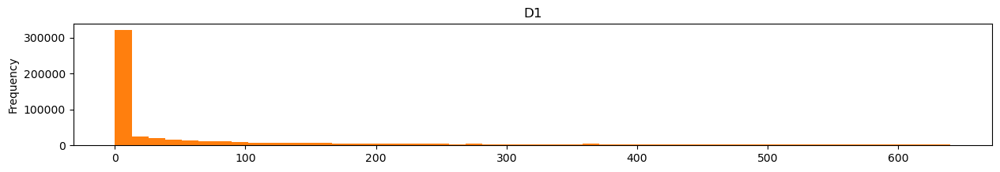

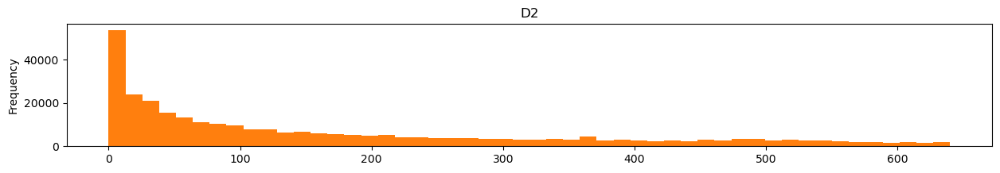

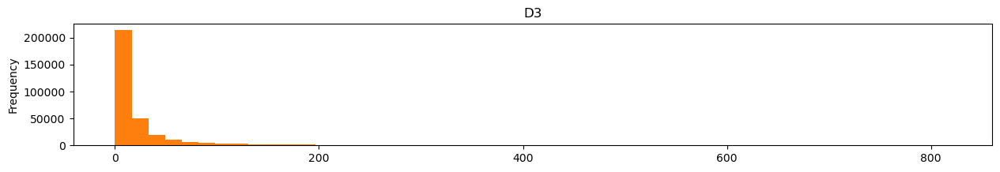

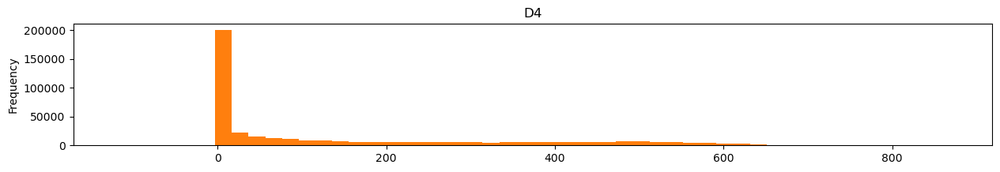

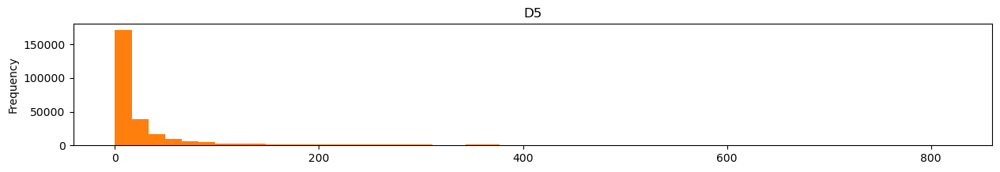

...

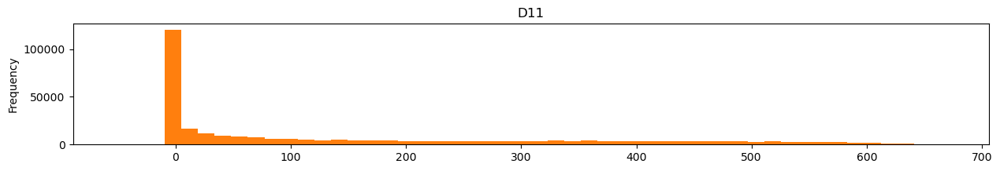

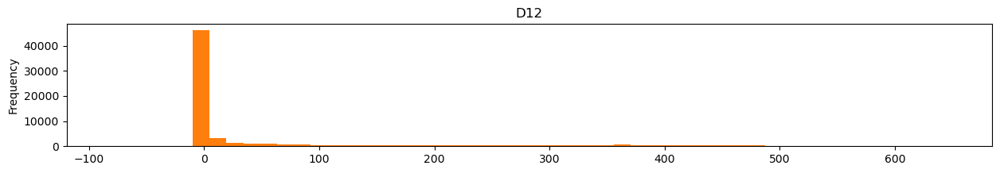

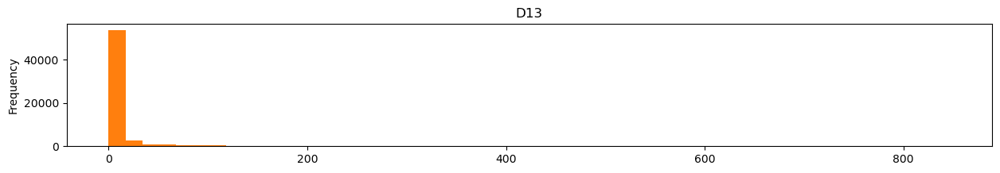

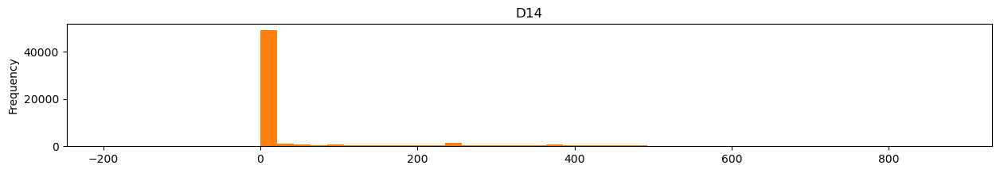

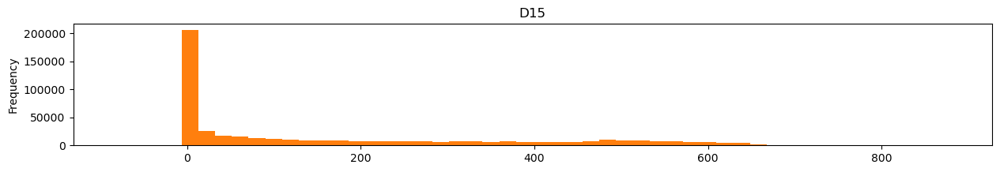

In [208]:
for c in D_cols[3:]:
    if df_transaction[c].dtype in ['float64','int64']:
        df_transaction[c].plot(kind='hist',
                                      title=c,
                                      bins=50,
                                      figsize=(15, 2),
                                      color=color_pal[1])

    plt.show()

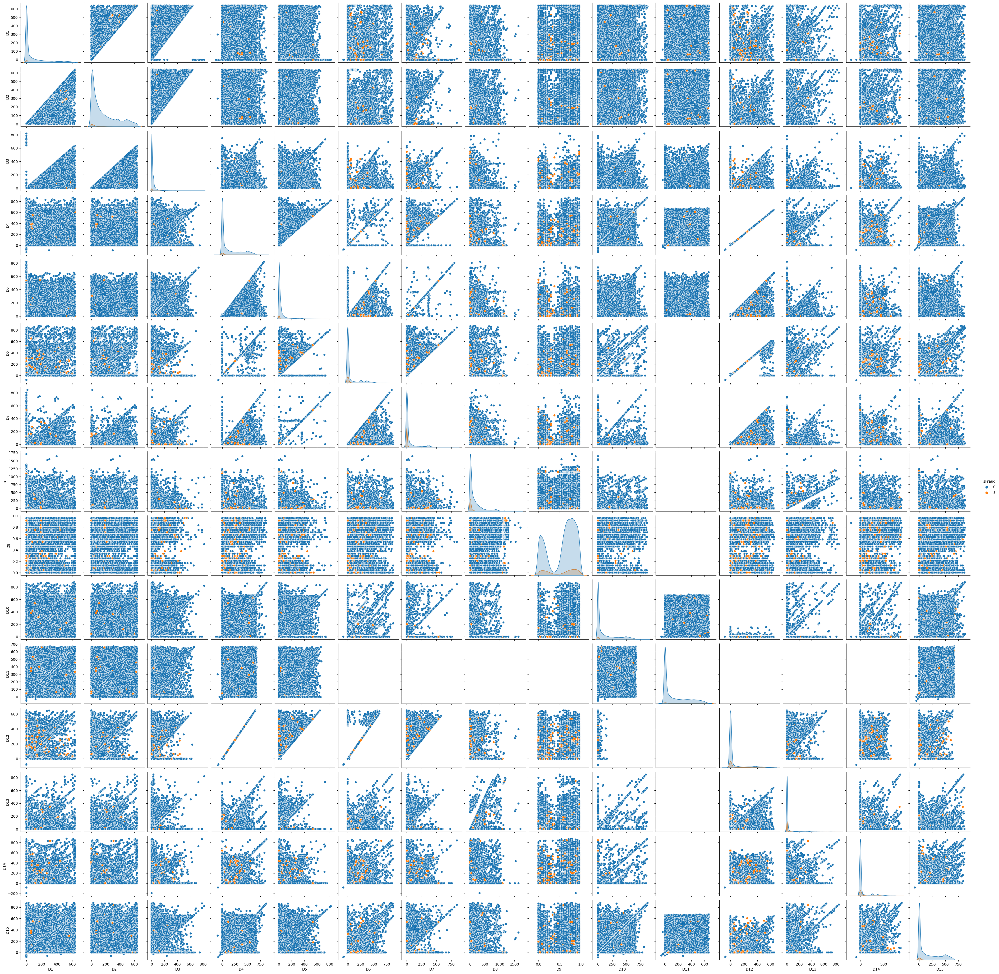

In [227]:
sns.pairplot(df_transaction, 
             hue='isFraud',
            vars=D_cols[3:])
plt.show()

### M1-M9

In [174]:
M_cols = [c for c in df_transaction.columns if 'M' in c]
df_transaction[M_cols]

,M1,M2,M3,M4,M5,M6,M7,M8,M9
0,T,T,T,M2,F,T,None,None,None
1,None,None,None,M0,T,T,None,None,None
2,T,T,T,M0,F,F,F,F,F
3,None,None,None,M0,T,F,None,None,None
4,None,None,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...
590535,T,T,T,M0,T,F,F,F,T
590536,T,F,F,M0,F,T,F,F,F
590537,T,F,F,None,None,T,None,None,None
590538,T,T,T,M0,F,T,None,None,None


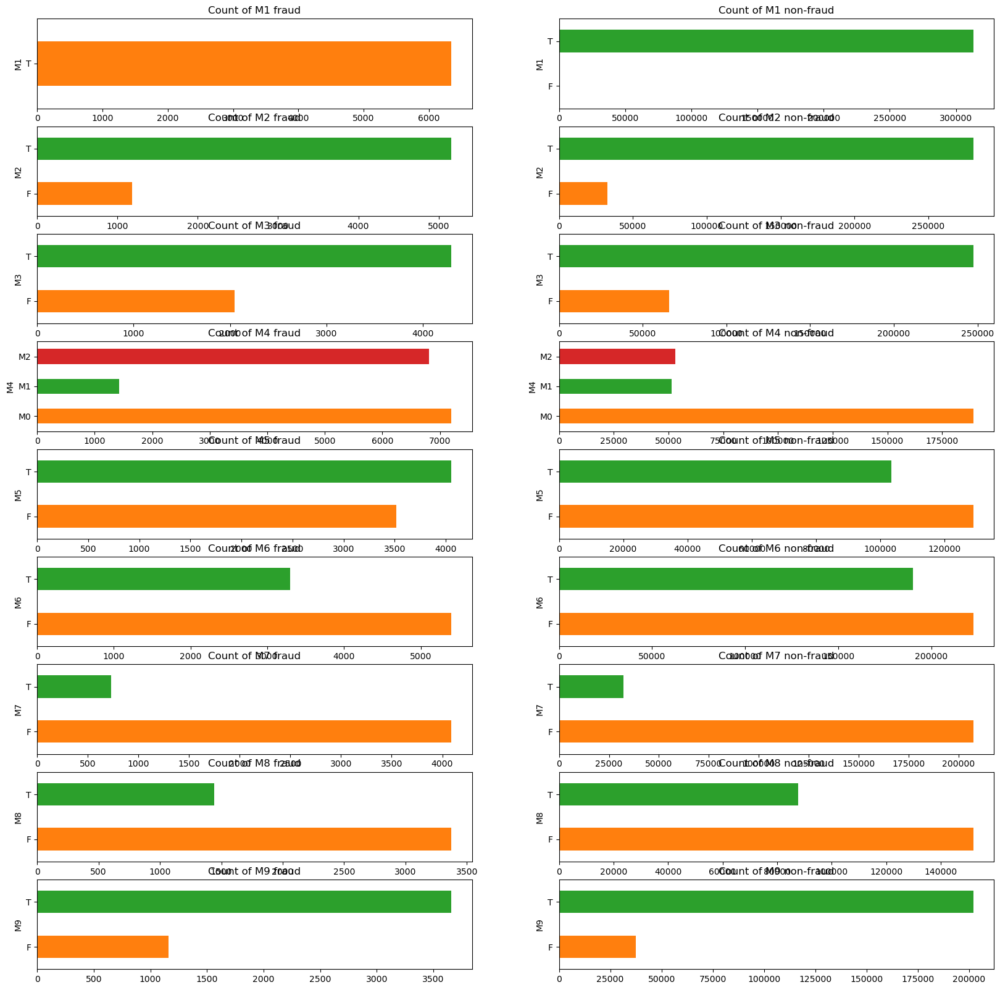

In [198]:
df_transaction_fr = df_transaction.loc[df_transaction['isFraud'] == 1]
df_transaction_nofr = df_transaction.loc[df_transaction['isFraud'] == 0]
fig, ((ax1, ax2),(ax3, ax4),(ax5, ax6),(ax7, ax8),(ax9, ax10),(ax11, ax12),(ax13, ax14),(ax15, ax16),(ax17, ax18)) = plt.subplots(9, 2, figsize=(20, 20))
df_transaction_fr.groupby('M1')['M1'].count().plot(kind='barh', ax=ax1, title='Count of M1 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M1')['M1'].count().plot(kind='barh', ax=ax2, title='Count of M1 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('M2')['M2'].count().plot(kind='barh', ax=ax3, title='Count of M2 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M2')['M2'].count().plot(kind='barh', ax=ax4, title='Count of M2 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('M3')['M3'].count().plot(kind='barh', ax=ax5, title='Count of M3 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M3')['M3'].count().plot(kind='barh', ax=ax6, title='Count of M3 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('M4')['M4'].count().plot(kind='barh', ax=ax7, title='Count of M4 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M4')['M4'].count().plot(kind='barh', ax=ax8, title='Count of M4 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('M5')['M5'].count().plot(kind='barh', ax=ax9, title='Count of M5 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M5')['M5'].count().plot(kind='barh', ax=ax10, title='Count of M5 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('M6')['M6'].count().plot(kind='barh', ax=ax11, title='Count of M6 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M6')['M6'].count().plot(kind='barh', ax=ax12, title='Count of M6 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('M7')['M7'].count().plot(kind='barh', ax=ax13, title='Count of M7 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M7')['M7'].count().plot(kind='barh', ax=ax14, title='Count of M7 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('M8')['M8'].count().plot(kind='barh', ax=ax15, title='Count of M8 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M8')['M8'].count().plot(kind='barh', ax=ax16, title='Count of M8 non-fraud',color = color_pal[1:5])
df_transaction_fr.groupby('M9')['M9'].count().plot(kind='barh', ax=ax17, title='Count of M9 fraud',color = color_pal[1:5])
df_transaction_nofr.groupby('M9')['M9'].count().plot(kind='barh', ax=ax18, title='Count of M9 non-fraud',color = color_pal[1:5])
plt.show()

### Vxxx

In [169]:
vxx_cols = [c for c in df_transaction.columns if 'V' in c]
df_transaction[vxx_cols]

,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,...,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
590535,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590536,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590537,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
590538,1.0,1.0,1.0,2.0,2.0,1.0,1.0,1.0,1.0,0.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


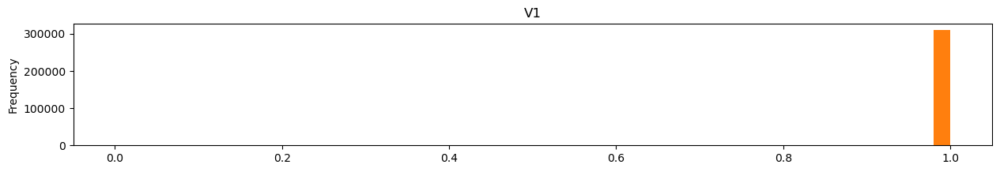

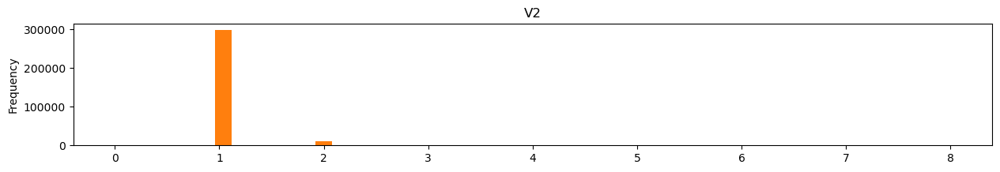

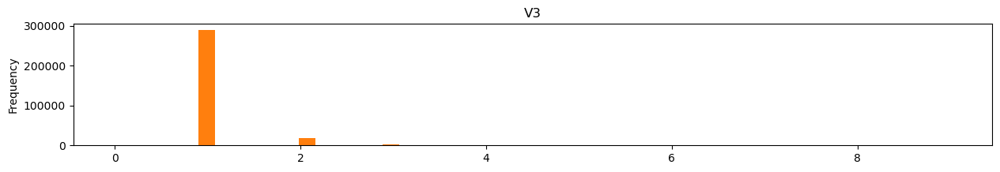

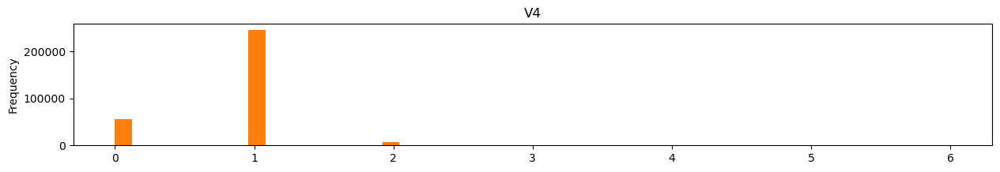

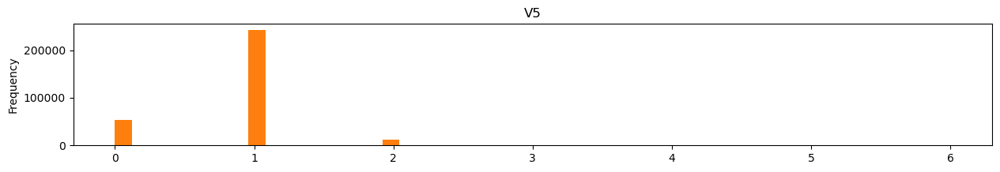

...

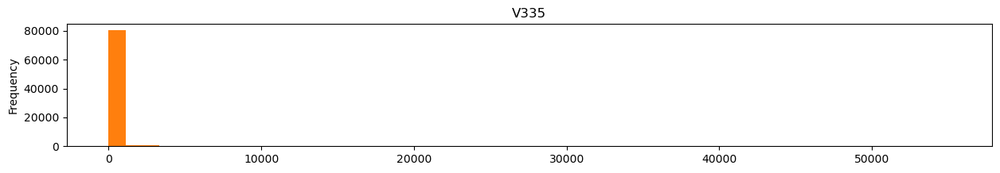

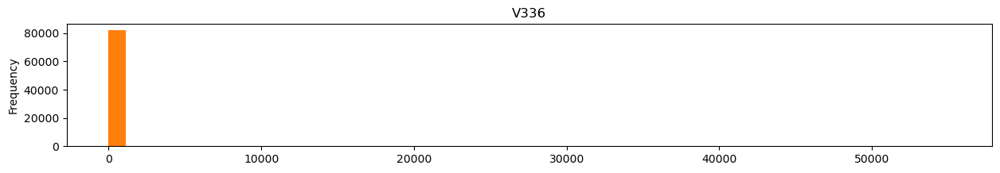

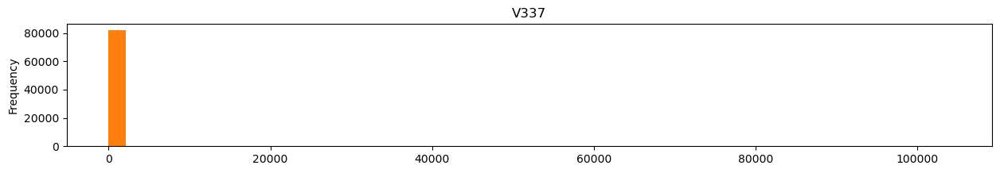

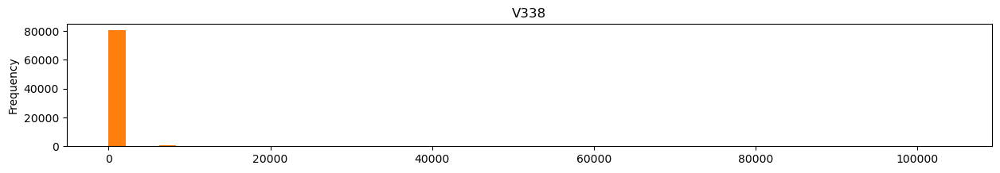

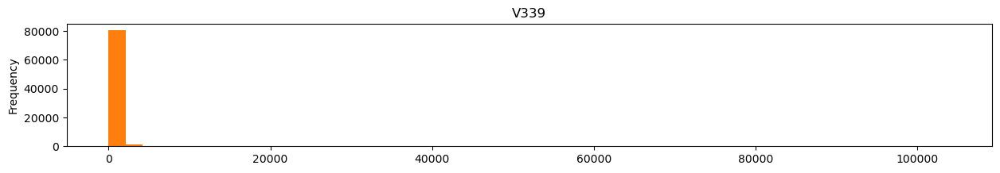

In [165]:
for c in vxx_cols:
    if df_transaction[c].dtype in ['float64','int64']:
        df_transaction[c].plot(kind='hist',
                                      title=c,
                                      bins=50,
                                      figsize=(15, 2),
                                      color=color_pal[1])

    plt.show()

### isFraud

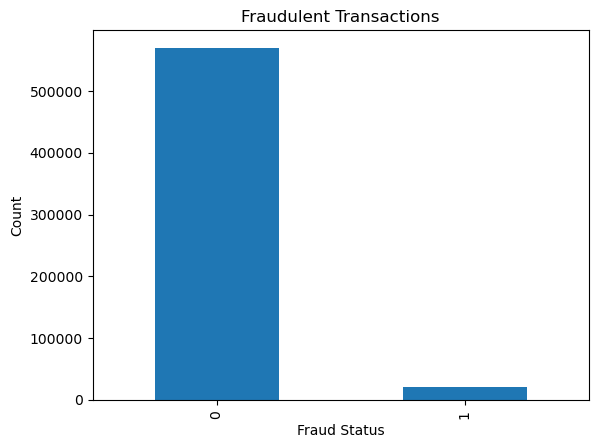

In [147]:
df['isFraud'].value_counts().plot.bar()
plt.title('Fraudulent Transactions')
plt.xlabel('Fraud Status')
plt.ylabel('Count')

# Display the plot
plt.show()

### TransactionID

In [146]:
df_transaction.TransactionID.nunique()

590540

## Identity

### DeviceType

<AxesSubplot:title={'center':'Count of DeviceType'}, ylabel='DeviceType'>

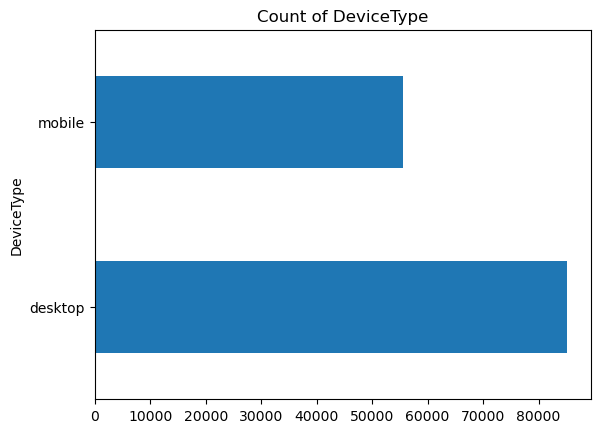

In [126]:
df_identity.groupby('DeviceType')['DeviceType'].count().plot(kind='barh', title='Count of DeviceType')

### DeviceInfo

In [131]:
df_identity.groupby('DeviceInfo')['DeviceInfo'].count()

DeviceInfo
0PAJ5             1
0PJA2             1
0PM92             4
1016S             1
2PQ93             1
                 ..
verykools5004     2
verykools5034     1
verykools5035     1
vivo              5
xs-Z47b7VqTMxs    1
Name: DeviceInfo, Length: 1786, dtype: int64

### id_xx

In [152]:
id_cols = [c for c in df_identity.columns if 'id_' in c]
df_identity[id_cols]

,id_01,id_02,id_03,id_04,id_05,id_06,id_07,id_08,id_09,id_10,...,id_29,id_30,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38
0,0.0,70787.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NotFound,Android 7.0,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T
1,-5.0,98945.0,NaN,NaN,0.0,-5.0,NaN,NaN,NaN,NaN,...,NotFound,iOS 11.1.2,mobile safari 11.0,32.0,1334x750,match_status:1,T,F,F,T
2,-5.0,191631.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,...,Found,NaN,chrome 62.0,NaN,NaN,NaN,F,F,T,T
3,-5.0,221832.0,NaN,NaN,0.0,-6.0,NaN,NaN,NaN,NaN,...,NotFound,NaN,chrome 62.0,NaN,NaN,NaN,F,F,T,T
4,0.0,7460.0,0.0,0.0,1.0,0.0,NaN,NaN,0.0,0.0,...,Found,Mac OS X 10_11_6,chrome 62.0,24.0,1280x800,match_status:2,T,F,T,T
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144228,-15.0,145955.0,0.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,...,Found,NaN,chrome 66.0 for android,NaN,NaN,NaN,F,F,T,F
144229,-5.0,172059.0,NaN,NaN,1.0,-5.0,NaN,NaN,NaN,NaN,...,NotFound,Android 7.1.1,chrome 55.0 for android,32.0,855x480,match_status:2,T,F,T,F
144230,-20.0,632381.0,NaN,NaN,-1.0,-36.0,NaN,NaN,NaN,NaN,...,NotFound,NaN,chrome 65.0 for android,NaN,NaN,NaN,F,F,T,F
144231,-5.0,55528.0,0.0,0.0,0.0,-7.0,NaN,NaN,0.0,0.0,...,Found,Mac OS X 10_9_5,chrome 66.0,24.0,2560x1600,match_status:2,T,F,T,F


For numerical data find, do plots.

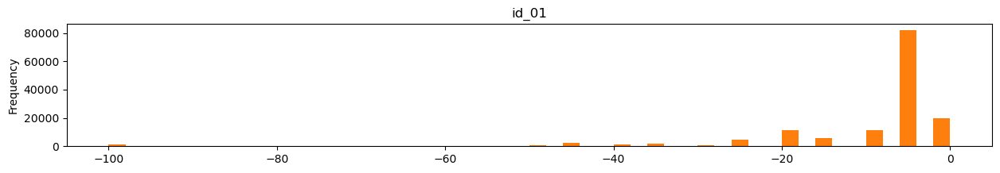

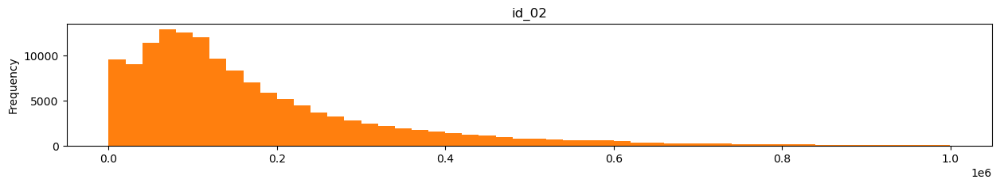

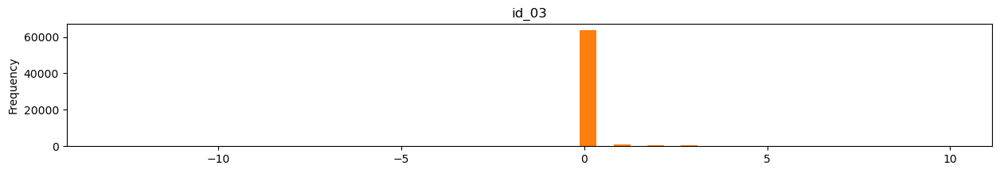

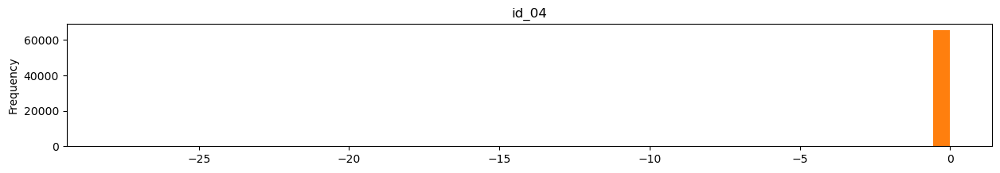

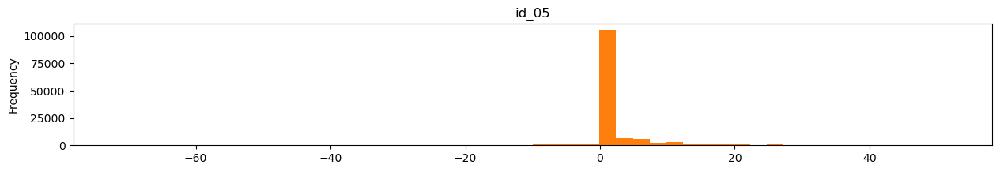

...

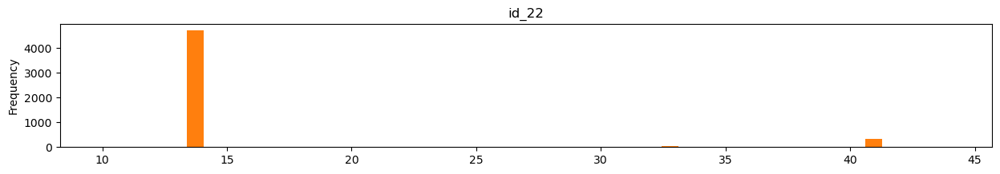

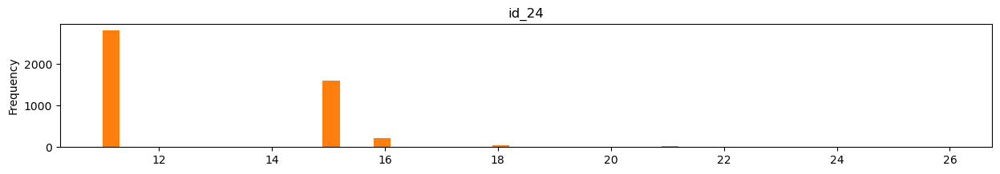

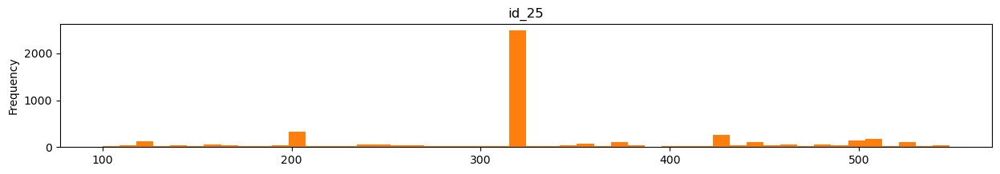

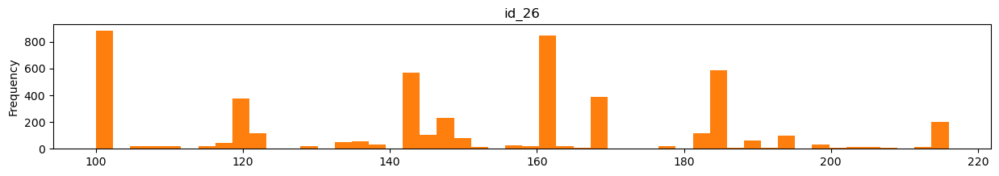

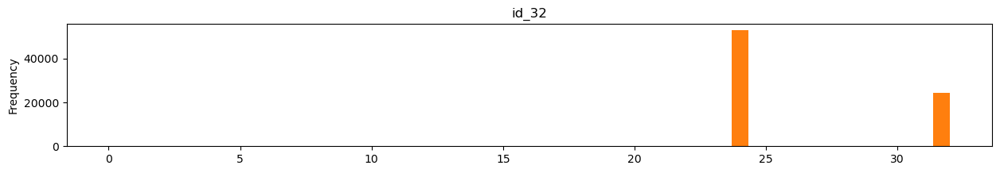

In [153]:
for c in id_cols:
    if df_identity[c].dtype in ['float64','int64']:
        df_identity[c].plot(kind='hist',
                                      title=c,
                                      bins=50,
                                      figsize=(15, 2),
                                      color=color_pal[1:100])
    color_idx += 1
    plt.show()

In [242]:
list_=[]
for c in id_cols:
    if df_identity[c].dtype not in ['float64','int64']:
        list_.append(c)

<AxesSubplot:title={'center':'id_15'}, ylabel='id_15'>

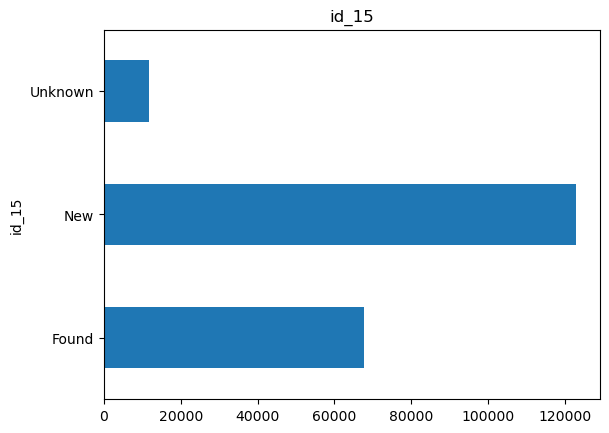

In [222]:


df_identity.groupby('id_12')['id_12'].count().plot(kind='barh', title='id_12')

<AxesSubplot:title={'center':'id_15'}, ylabel='id_15'>

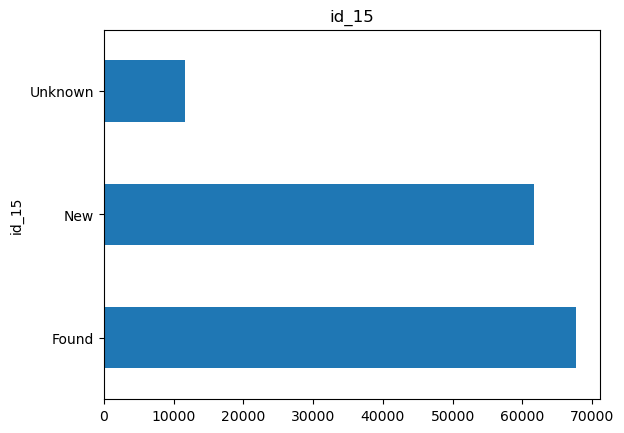

In [223]:
        
df_identity.groupby('id_15')['id_15'].count().plot(kind='barh', title='id_15')

In [ ]:
        
df_identity.groupby('id_16')['id_16'].count().plot(kind='barh', title='id_16')

<AxesSubplot:title={'center':'id_23'}, ylabel='id_23'>

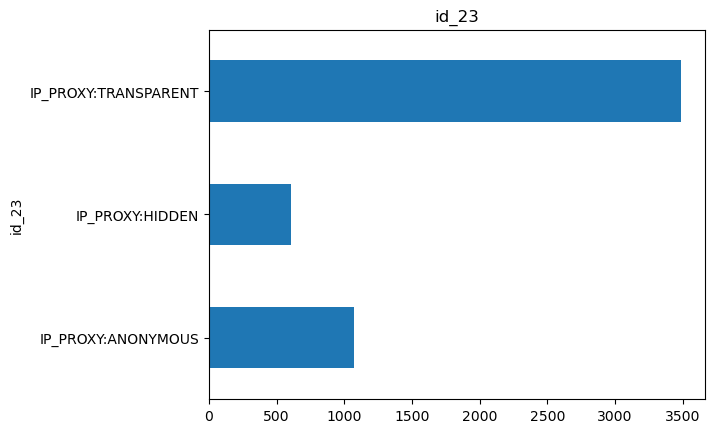

In [224]:
        
df_identity.groupby('id_23')['id_23'].count().plot(kind='barh', title='id_23')

<AxesSubplot:title={'center':'id_27'}, ylabel='id_27'>

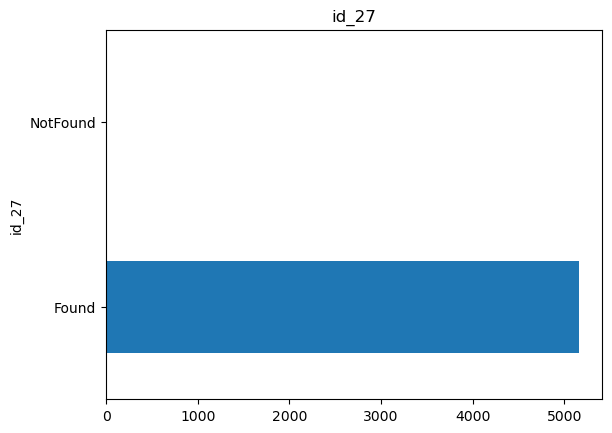

In [225]:
df_identity.groupby('id_27')['id_27'].count().plot(kind='barh', title='id_27')


<AxesSubplot:title={'center':'id_28'}, ylabel='id_28'>

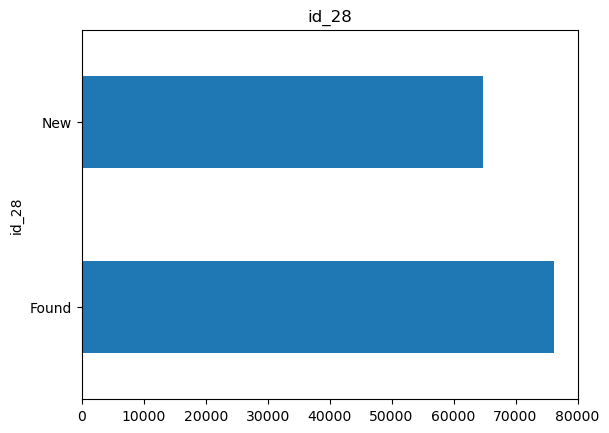

In [226]:
df_identity.groupby('id_28')['id_28'].count().plot(kind='barh', title='id_28')

In [ ]:
df_identity.groupby('id_29')['id_29'].count().plot(kind='barh', title='id_29')

In [ ]:
df_identity.groupby('id_30')['id_30'].count().plot(kind='barh', title='id_30')

In [ ]:
df_identity.groupby('id_31')['id_31'].count().plot(kind='barh', title='id_31')

In [ ]:
df_identity.groupby('id_33')['id_33'].count().plot(kind='barh', title='id_33')

In [ ]:
df_identity.groupby('id_34')['id_34'].count().plot(kind='barh', title='id_34')

In [ ]:
df_identity.groupby('id_35')['id_35'].count().plot(kind='barh', title='id_35')

In [ ]:
df_identity.groupby('id_36')['id_36'].count().plot(kind='barh', title='id_36')

In [ ]:
df_identity.groupby('id_37')['id_37'].count().plot(kind='barh', title='id_37')

In [ ]:
df_identity.groupby('id_38')['id_38'].count().plot(kind='barh', title='id_38')

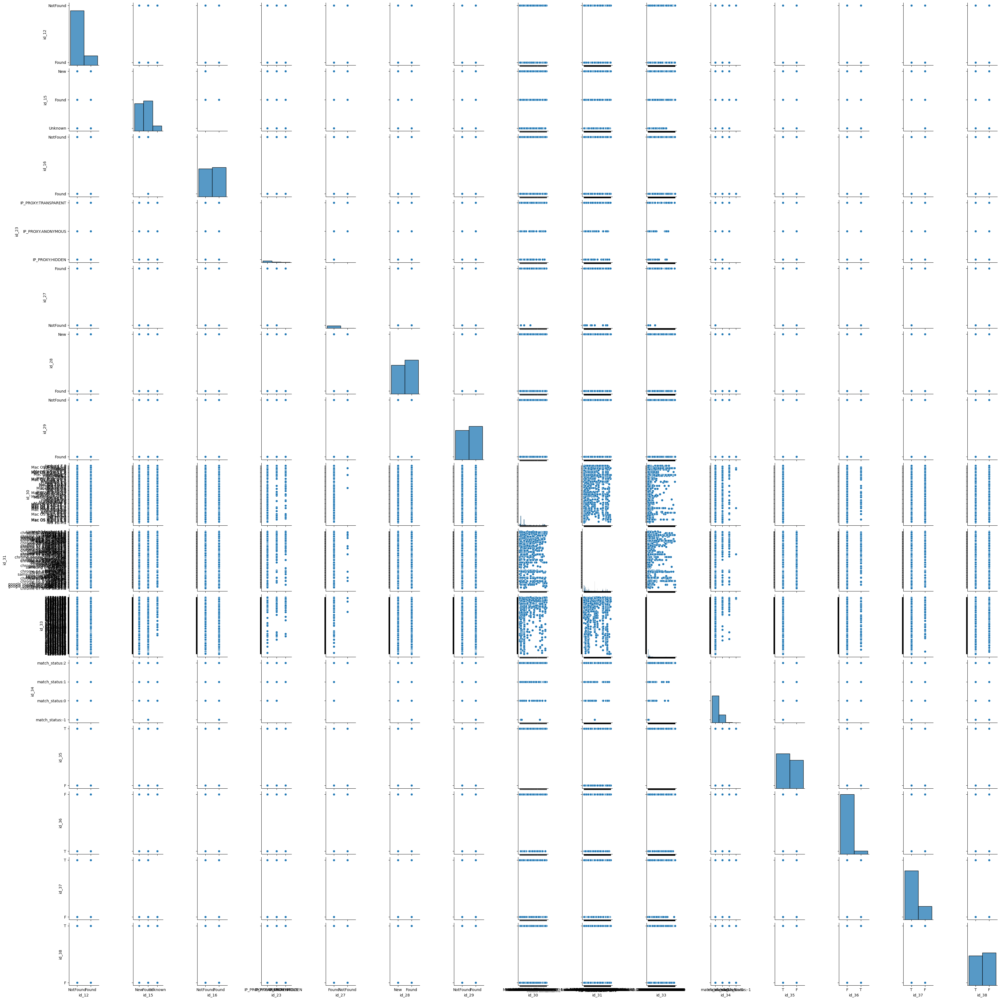

In [249]:
sns.pairplot(df_identity,  
            vars=list_)
plt.show()

### TransactionID

In [252]:
df_identity.TransactionID.nunique()

144233

## Merge Data

In [21]:
df = df_transaction.merge(df_identity, on='TransactionID', how='left')
df.head()

,TransactionID,isFraud,TransactionDT,TransactionAmt,ProductCD,card1,card2,card3,card4,card5,...,id_31,id_32,id_33,id_34,id_35,id_36,id_37,id_38,DeviceType,DeviceInfo
0,2987000,0,86400,68.5,W,13926,NaN,150.0,discover,142.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2987001,0,86401,29.0,W,2755,404.0,150.0,mastercard,102.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2987002,0,86469,59.0,W,4663,490.0,150.0,visa,166.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2987003,0,86499,50.0,W,18132,567.0,150.0,mastercard,117.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2987004,0,86506,50.0,H,4497,514.0,150.0,mastercard,102.0,...,samsung browser 6.2,32.0,2220x1080,match_status:2,T,F,T,T,mobile,SAMSUNG SM-G892A Build/NRD90M


In [22]:
df.shape

(590540, 434)

In [23]:
df.info

<bound method DataFrame.info of         TransactionID  isFraud  TransactionDT  TransactionAmt ProductCD  \
0             2987000        0          86400           68.50         W   
1             2987001        0          86401           29.00         W   
2             2987002        0          86469           59.00         W   
3             2987003        0          86499           50.00         W   
4             2987004        0          86506           50.00         H   
...               ...      ...            ...             ...       ...   
590535        3577535        0       15811047           49.00         W   
590536        3577536        0       15811049           39.50         W   
590537        3577537        0       15811079           30.95         W   
590538        3577538        0       15811088          117.00         W   
590539        3577539        0       15811131          279.95         W   

        card1  card2  card3       card4  card5  ...                

### DeviceType & isFraud

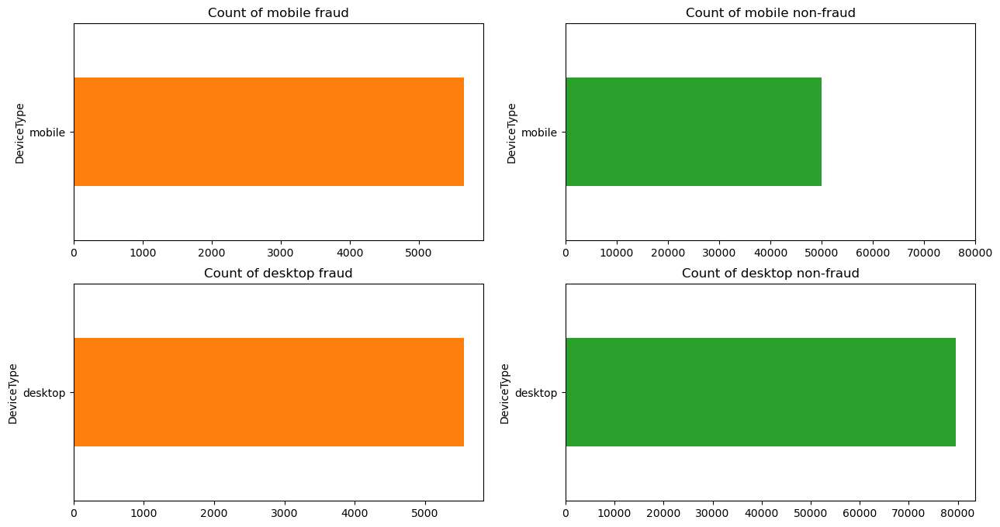

In [30]:
df_fr = df.loc[df['isFraud'] == 1]
df_nofr = df.loc[df['isFraud'] == 0]
fig, ((ax1, ax2),(ax3, ax4)) = plt.subplots(2, 2, figsize=(15, 8))
df_fr[df_fr['DeviceType']=='mobile'].groupby('DeviceType')['DeviceType'].count().plot(kind='barh', ax=ax1, title='Count of mobile fraud',color = color_pal[1])
ax=df_nofr[df_nofr['DeviceType']=='mobile'].groupby('DeviceType')['DeviceType'].count().plot(kind='barh', ax=ax2, title='Count of mobile non-fraud',color = color_pal[2])
ax.set_xlim([0, 80000])
# set x-axis limits to range from 0 to 80000
df_fr[df_fr['DeviceType']=='desktop'].groupby('DeviceType')['DeviceType'].count().plot(kind='barh', ax=ax3, title='Count of desktop fraud',color = color_pal[1])
df_nofr[df_nofr['DeviceType']=='desktop'].groupby('DeviceType')['DeviceType'].count().plot(kind='barh', ax=ax4, title='Count of desktop non-fraud',color = color_pal[2])
# display the plot
plt.show()



## Id_xx& isFraud

In [1]:
df_fr = df.loc[df['isFraud'] == 1]
df_nofr = df.loc[df['isFraud'] == 0]
fig, ((ax1, ax2),(ax3, ax4),(ax5, ax6),(ax7, ax8),(ax9, ax10),(ax11, ax12),(ax13, ax14),(ax15, ax16),(ax17, ax18),(ax19, ax20),(ax21, ax22),(ax23, ax24),(ax25, ax26),(ax27, ax28),(ax29, ax30)) = plt.subplots(15, 2, figsize=(20, 20))
df_fr.groupby('id_12')['id_12'].count().plot(kind='barh', ax=ax1, title='Count of id_12 fraud',color = color_pal[1:5])
df_nofr.groupby('id_12')['id_12'].count().plot(kind='barh', ax=ax2, title='Count of id_12 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_33')['id_33'].count().plot(kind='barh', ax=ax3, title='Count of id_33 fraud',color = color_pal[1:5])
df_nofr.groupby('id_33')['id_33'].count().plot(kind='barh', ax=ax4, title='Count of id_33 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_34')['id_34'].count().plot(kind='barh', ax=ax5, title='Count of id_34 fraud',color = color_pal[1:5])
df_nofr.groupby('id_34')['id_34'].count().plot(kind='barh', ax=ax6, title='Count of id_34 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_35')['id_35'].count().plot(kind='barh', ax=ax7, title='Count of id_35 fraud',color = color_pal[1:5])
df_nofr.groupby('id_35')['id_35'].count().plot(kind='barh', ax=ax8, title='Count of id_35 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_36')['id_36'].count().plot(kind='barh', ax=ax9, title='Count of id_36 fraud',color = color_pal[1:5])
df_nofr.groupby('id_36')['id_36'].count().plot(kind='barh', ax=ax10, title='Count of id_36 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_37')['id_37'].count().plot(kind='barh', ax=ax11, title='Count of id_37 fraud',color = color_pal[1:5])
df_nofr.groupby('id_37')['id_37'].count().plot(kind='barh', ax=ax12, title='Count of id_37 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_38')['id_38'].count().plot(kind='barh', ax=ax13, title='Count of id_38 fraud',color = color_pal[1:5])
df_nofr.groupby('id_38')['id_38'].count().plot(kind='barh', ax=ax14, title='Count of id_38 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_29')['id_29'].count().plot(kind='barh', ax=ax15, title='Count of id_29 fraud',color = color_pal[1:5])
df_nofr.groupby('id_29')['id_29'].count().plot(kind='barh', ax=ax16, title='Count of id_29 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_30')['id_30'].count().plot(kind='barh', ax=ax17, title='Count of id_30 fraud',color = color_pal[1:5])
df_nofr.groupby('id_30')['id_30'].count().plot(kind='barh', ax=ax18, title='Count of id_30 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_31')['id_31'].count().plot(kind='barh', ax=ax19, title='Count of id_31fraud',color = color_pal[1:5])
df_nofr.groupby('id_31')['id_31'].count().plot(kind='barh', ax=ax20, title='Count of id_31 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_27')['id_27'].count().plot(kind='barh', ax=ax21, title='Count of id_27 fraud',color = color_pal[1:5])
df_nofr.groupby('id_27')['id_27'].count().plot(kind='barh', ax=ax22, title='Count of id_27 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_28')['id_28'].count().plot(kind='barh', ax=ax23, title='Count of id_28fraud',color = color_pal[1:5])
df_nofr.groupby('id_28')['id_28'].count().plot(kind='barh', ax=ax24, title='Count of id_28 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_15')['id_15'].count().plot(kind='barh', ax=ax25, title='Count of id_15fraud',color = color_pal[1:5])
df_nofr.groupby('id_15')['id_15'].count().plot(kind='barh', ax=ax26, title='Count of id_15 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_16')['id_16'].count().plot(kind='barh', ax=ax27, title='Count of id_16 fraud',color = color_pal[1:5])
df_nofr.groupby('id_16')['id_16'].count().plot(kind='barh', ax=ax28, title='Count of id_16 non-fraud',color = color_pal[1:5])
df_fr.groupby('id_23')['id_23'].count().plot(kind='barh', ax=ax29, title='Count of id_23fraud',color = color_pal[1:5])
df_nofr.groupby('id_23')['id_23'].count().plot(kind='barh', ax=ax30, title='Count of id_23 non-fraud',color = color_pal[1:5])
plt.show()

NameError: name 'df' is not defined

# Main points

## Check missing value

In [31]:
missing_values_count = df.isnull().sum()
missing_values_count
total_cells = np.product(df.shape)
total_missing = missing_values_count.sum()
print ("% of missing data = ",(total_missing/total_cells) * 100)

% of missing data =  45.074371905803936


## Check imbalance

In [33]:
df.TransactionID.nunique()

590540

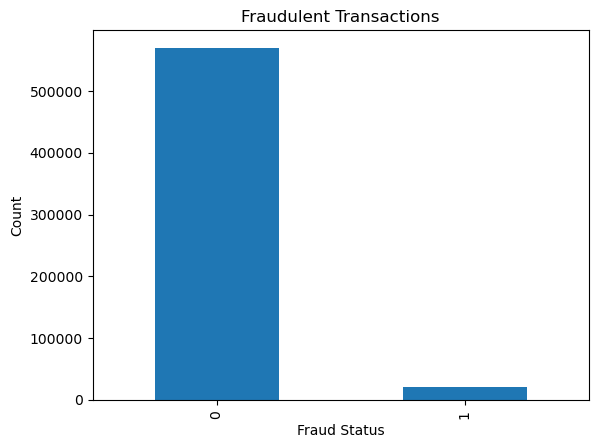

In [55]:
df['isFraud'].value_counts().plot.bar()
plt.title('Fraudulent Transactions')
plt.xlabel('Fraud Status')
plt.ylabel('Count')

# Display the plot
plt.show()